## HW2
#### Import libs

In [328]:
import pandas as pd
import altair as alt

#### Import data

In [329]:
df = pd.read_excel('./data/2014-2020.xlsx')
df.head()

,Час/Дата,AES,TEC,VDE,TES,GES,GAES_GEN,CONSUMPTION,GAES_PUMP,UK_BLR_RUS,UK_EURO,UK_MLD,Unnamed: 12
0,24-31.12.2020,9235,2039,621,4942,385.0,0,16693,-405.0,-84.0,-11.0,-29.0,NaN
1,23-31.12.2020,9221,2159,707,5549,470.0,0,17805,0.0,-43.0,-212.0,-46.0,NaN
2,22-31.12.2020,9249,2377,709,5906,1000.0,0,18870,0.0,-13.0,-328.0,-30.0,NaN
3,21-31.12.2020,9256,2499,702,6329,909.0,322,19887,0.0,0.0,-64.0,-66.0,NaN
4,20-31.12.2020,9213,2521,702,6640,823.0,602,20387,0.0,-29.0,-48.0,-37.0,NaN


In [330]:
df = df.drop(['GAES_PUMP', 'UK_BLR_RUS', 'UK_EURO', 'UK_MLD', 'Unnamed: 12'], axis=1)
df.head()

,Час/Дата,AES,TEC,VDE,TES,GES,GAES_GEN,CONSUMPTION
0,24-31.12.2020,9235,2039,621,4942,385.0,0,16693
1,23-31.12.2020,9221,2159,707,5549,470.0,0,17805
2,22-31.12.2020,9249,2377,709,5906,1000.0,0,18870
3,21-31.12.2020,9256,2499,702,6329,909.0,322,19887
4,20-31.12.2020,9213,2521,702,6640,823.0,602,20387


In [25]:
column_list = ['AES', 'TEC', 'VDE', 'TES', 'GES', 'GAES_GEN']

In [116]:
prep_df = df.copy()
prep_df['year'] = df['Час/Дата'].apply(lambda x: int(x.split('-')[1].split('.')[2]))
prep_df = prep_df.groupby(['year'], as_index=False)[column_list].sum()
prep_df.head()

,year,AES,TEC,VDE,TES,GES,GAES_GEN
0,2014,88204418,14684731,1606386,68605877,7991074.0,839842
1,2015,87413763,12041074,1234936,50259819,4964478.0,1554857
2,2016,80762094,12841033,1093190,49879543,7113989.0,1621377
3,2017,85314258,12208062,1177032,44945303,8531952.0,1575099
4,2018,84351328,12261018,1863726,47747092,10072767.0,1564867


In [121]:
prep_df2 = pd.melt(prep_df, id_vars=['year'], value_vars=column_list)
prep_df2.head()

,year,variable,value
0,2014,AES,88204418.0
1,2015,AES,87413763.0
2,2016,AES,80762094.0
3,2017,AES,85314258.0
4,2018,AES,84351328.0


#### Task 1: Як змінювалась структура генерації електроенергії за роками?

In [141]:
alt.Chart(prep_df2).mark_bar().encode(
    x = alt.X(
        'value:Q',
        title = 'Кількість згенерованої електроенергії (кВт)',
    ),
    y = alt.Y(
        'year:N',
        title = 'Рік',
    ),
    color = alt.Color(
        'variable:N',
        title = 'Вид електростанції',
        scale=alt.Scale(scheme='darkred')
    ),
    tooltip = alt.Tooltip('year')
).properties(width = 950, height = 500)

alt.Chart(...)

### Description:
- The plot shows how the generation of electroenergy has been changing during the years.
- At the OX scale we have (кВт) - the exact number of generated energy.
- At the OY scale we have years.
- The color indicates the type of the electrostation. Moreover the darker color, closer to red mostly indicates the bigger amount of generated energy.
- The bars decided to be horizontal, as it doesn't make the user think that one color is above the other, so it does metter more.

### Task 2: Як залежить споживання електроенергії від дня року та години доби?

In [237]:
prep_df = df.copy()
prep_df['hour'] = prep_df['Час/Дата'].apply(lambda x: int(x.split('-')[0]))
prep_df['day'] = prep_df['Час/Дата'].apply(lambda x: int(x.split('-')[1].split('.')[0]))
prep_df['month'] = prep_df['Час/Дата'].apply(lambda x: int(x.split('-')[1].split('.')[1]))
prep_df['year'] = prep_df['Час/Дата'].apply(lambda x: int(x.split('-')[1].split('.')[2]))
prep_df.drop(['Час/Дата', ]+column_list, axis=1, inplace=True)
prep_df['dayOfYear'] = pd.to_datetime(prep_df[['year', 'month', 'day']], format='%d%m')
prep_df.head()

,CONSUMPTION,hour,day,month,year,dayOfYear
0,16693,24,31,12,2020,2020-12-31
1,17805,23,31,12,2020,2020-12-31
2,18870,22,31,12,2020,2020-12-31
3,19887,21,31,12,2020,2020-12-31
4,20387,20,31,12,2020,2020-12-31


In [238]:
prep_df.drop(['day', 'year', 'month'], axis=1, inplace=True)
prep_df['day-month'] = prep_df['dayOfYear'].dt.strftime('%m-%d')
prep_df.head()

,CONSUMPTION,hour,dayOfYear,day-month
0,16693,24,2020-12-31,12-31
1,17805,23,2020-12-31,12-31
2,18870,22,2020-12-31,12-31
3,19887,21,2020-12-31,12-31
4,20387,20,2020-12-31,12-31


In [239]:
prep_df.drop(['dayOfYear',], axis=1, inplace=True)

In [240]:
prep_df = prep_df.groupby(['day-month', 'hour'], as_index=False)['CONSUMPTION'].mean()
prep_df

,day-month,hour,CONSUMPTION
0,01-01,1,18202.428571
1,01-01,2,17436.142857
2,01-01,3,16873.428571
3,01-01,4,16460.571429
4,01-01,5,16287.142857
...,...,...,...
8779,12-31,20,21152.000000
8780,12-31,21,20662.285714
8781,12-31,22,20010.571429
8782,12-31,23,19178.428571


In [241]:
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [331]:
prep_df['day-month']

0        12-31
1        12-31
2        12-31
3        12-31
4        12-31
         ...  
61363    01-01
61364    01-01
61365    01-01
61366    01-01
61367    01-01
Name: day-month, Length: 61368, dtype: object

In [332]:
alt.Chart(prep_df).mark_rect().encode(
    x = alt.X('day-month:O',
              title='Місяць і день'),
    y = alt.Y('hour:O', title='Година'),
    color = alt.Color('CONSUMPTION:Q', title='Споживання', scale=alt.Scale(scheme='yelloworangered'))
).properties(
    title='Залежність споживання електроенергії від дня року та години доби',
    width = 950,
)

alt.Chart(...)

### Description:
- The plot shows dependancy among electroenergy consumption and day of the year and hour.
- The OX scale shows the day and the month.
- The OY scale shows the hour.
- The color indicates the amount of consumption. As more energy was consumed, as more the color becomes red.

### Task 3: Як змінюється генерація електроенергії з різних джерел впродовж доби?

In [351]:
prep_df = df.copy()
prep_df['hour'] = prep_df['Час/Дата'].apply(lambda x: int(x.split('-')[0]))
prep_df.drop(['Час/Дата', 'CONSUMPTION'], axis=1, inplace=True)
prep_df = prep_df.groupby(['hour'], as_index=False)[column_list].sum()
prep_df.head()

,hour,AES,TEC,VDE,TES,GES,GAES_GEN
0,1,24377870,3652830,419804,12486689,1057721.0,683
1,2,24369995,3643390,421276,12203892,833083.0,0
2,3,24368841,3644296,421149,12075285,804489.0,0
3,4,24372860,3639920,419808,11978383,741463.0,0
4,5,24381678,3645933,422058,12012699,826560.0,0


In [354]:
prep_df2 = pd.melt(prep_df, id_vars=['hour'], value_vars=column_list)
prep_df2.rename(columns={'variable': 'Вид електростанції'}, inplace=True)
prep_df2.head()

,hour,Вид електростанції,value
0,1,AES,24377870.0
1,2,AES,24369995.0
2,3,AES,24368841.0
3,4,AES,24372860.0
4,5,AES,24381678.0


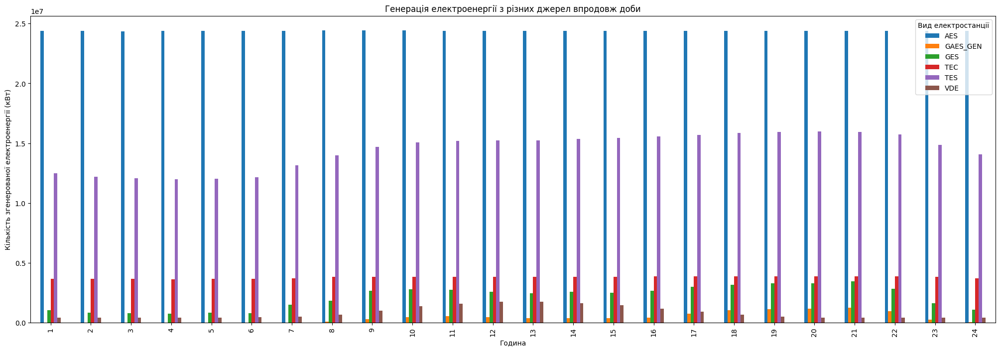

In [363]:
# ! pip install matplotlib
import matplotlib.pyplot as plt
import matplotlib as mpl

mpl.style.use('default')
plt.rcParams["figure.figsize"] = (25,8)
prep_df2.pivot("hour", "Вид електростанції", "value").plot(kind='bar',
                                                 title = 'Генерація електроенергії з різних джерел впродовж доби',
                                                 xlabel='Година',
                                                 ylabel='Кількість згенерованої електроенергії (кВт)')

plt.show()

#### Descriptoion:
- OY shows the amont of generated energy.
- OX shows the hour of the day.
- We can clearly see which types of electrodstations generate more energy during the day.
- Moreover the user can concentrate the focus on one color and see how the distribution changes on the axis OX.

### Task 4: Як змінюється споживання електроенергії впродовж доби у розрізі місяців року та пір року?

In [364]:
prep_df = df.copy()
prep_df['hour'] = prep_df['Час/Дата'].apply(lambda x: int(x.split('-')[0]))
prep_df['day'] = prep_df['Час/Дата'].apply(lambda x: int(x.split('-')[1].split('.')[0]))
prep_df['month'] = prep_df['Час/Дата'].apply(lambda x: int(x.split('-')[1].split('.')[1]))
prep_df['year'] = prep_df['Час/Дата'].apply(lambda x: int(x.split('-')[1].split('.')[2]))
prep_df.drop(['Час/Дата', ]+column_list, axis=1, inplace=True)
prep_df['dayOfYear'] = pd.to_datetime(prep_df[['year', 'month', 'day']], format='%d%m')
prep_df.head()

,CONSUMPTION,hour,day,month,year,dayOfYear
0,16693,24,31,12,2020,2020-12-31
1,17805,23,31,12,2020,2020-12-31
2,18870,22,31,12,2020,2020-12-31
3,19887,21,31,12,2020,2020-12-31
4,20387,20,31,12,2020,2020-12-31


In [365]:
import calendar
prep_df['Month'] = prep_df['month'].apply(lambda x: calendar.month_abbr[x])
prep_df['season'] = prep_df['month'].apply(lambda x: x%12 // 3 + 1)
prep_df['day-month'] = prep_df['dayOfYear'].dt.strftime('%m-%d')
prep_df.head()

,CONSUMPTION,hour,day,month,year,dayOfYear,Month,season,day-month
0,16693,24,31,12,2020,2020-12-31,Dec,1,12-31
1,17805,23,31,12,2020,2020-12-31,Dec,1,12-31
2,18870,22,31,12,2020,2020-12-31,Dec,1,12-31
3,19887,21,31,12,2020,2020-12-31,Dec,1,12-31
4,20387,20,31,12,2020,2020-12-31,Dec,1,12-31


In [366]:
def get_season(num):
    if num == 1:
        return 'Winter'
    elif num==2:
        return 'Spring'
    elif num==3:
        return 'Summer'
    else:
        return 'Autumn'

prep_df['Season'] = prep_df['season'].apply(lambda x: get_season(x))

In [367]:
prep_df.drop(['season'], axis=1, inplace=True)
prep_df.head()

,CONSUMPTION,hour,day,month,year,dayOfYear,Month,day-month,Season
0,16693,24,31,12,2020,2020-12-31,Dec,12-31,Winter
1,17805,23,31,12,2020,2020-12-31,Dec,12-31,Winter
2,18870,22,31,12,2020,2020-12-31,Dec,12-31,Winter
3,19887,21,31,12,2020,2020-12-31,Dec,12-31,Winter
4,20387,20,31,12,2020,2020-12-31,Dec,12-31,Winter


In [368]:
prep_df2 = prep_df.groupby(['Month', 'hour'], as_index=False)['CONSUMPTION'].mean()
prep_df2

,Month,hour,CONSUMPTION
0,Apr,1,14712.419048
1,Apr,2,14177.652381
2,Apr,3,13951.961905
3,Apr,4,13924.000000
4,Apr,5,14090.052381
...,...,...,...
283,Sep,20,17299.923810
284,Sep,21,17257.861905
285,Sep,22,16133.933333
286,Sep,23,14992.033333


In [373]:
alt.Chart(prep_df).mark_rect().encode(
    x = alt.X('Month:O', title=''),
    y = alt.Y('hour:O', title='Година'),
    column = alt.Column('Season:N', title='Сезони'),
    color = alt.Color('CONSUMPTION:Q', title='Споживання', scale=alt.Scale(scheme='yelloworangered'))
).resolve_scale(
    x='independent'
).properties(
    width = 950/len(pd.unique(prep_df.Season)),
    height = 500,
    background = '#F9F9F9',
    padding = 25
)

alt.Chart(...)

#### Description:
- I used heatmaps, as we can show descrite values with them.
- Here we have 4 heatmaps for each season.
- On OX axis each season seperated into 3 months. The value for each hour that is on OY axis is the mean of values that were during the month.
- The more the color is red, the higher the consuption of some particular electrioenergy was.

### Task 5: Як змінюється споживання електроенергії впродовж тижня?

In [381]:
prep_df = df.copy()
prep_df['hour'] = prep_df['Час/Дата'].apply(lambda x: int(x.split('-')[0]))
prep_df['day'] = prep_df['Час/Дата'].apply(lambda x: int(x.split('-')[1].split('.')[0]))
prep_df['month'] = prep_df['Час/Дата'].apply(lambda x: int(x.split('-')[1].split('.')[1]))
prep_df['year'] = prep_df['Час/Дата'].apply(lambda x: int(x.split('-')[1].split('.')[2]))
prep_df.drop(['Час/Дата', ]+column_list, axis=1, inplace=True)
prep_df['dayOfYear'] = pd.to_datetime(prep_df[['year', 'month', 'day']], format='%d%m')
prep_df.head()

,CONSUMPTION,hour,day,month,year,dayOfYear
0,16693,24,31,12,2020,2020-12-31
1,17805,23,31,12,2020,2020-12-31
2,18870,22,31,12,2020,2020-12-31
3,19887,21,31,12,2020,2020-12-31
4,20387,20,31,12,2020,2020-12-31


In [382]:
prep_df['day_of_week'] = prep_df['dayOfYear'].dt.day_name()
prep_df.drop(['dayOfYear', 'hour', 'day', 'year', 'month'], axis=1, inplace=True)
prep_df = prep_df.groupby(['day_of_week'], as_index=False)['CONSUMPTION'].sum()

prep_df.head()

,day_of_week,CONSUMPTION
0,Friday,151607773
1,Monday,150392617
2,Saturday,146672448
3,Sunday,141846683
4,Thursday,152807171


In [390]:
alt.Chart(prep_df).mark_bar().encode(
    x = alt.X(
        'day_of_week:O',
        sort=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'],
        title = 'День тижня',
    ),
    y = alt.Y(
        'CONSUMPTION:Q',
        title = 'Споживання',
    ),
    # TODO change color
    color = alt.Color(
        'day_of_week:O',
        sort=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'],
        scale=alt.Scale(scheme='greens')
    ),
    tooltip = [
        alt.Tooltip('day_of_week:O', title='День тижня'),
        alt.Tooltip('CONSUMPTION:Q', title='Споживання')
    ]
).properties(
    title='Споживання електроенергії протягом тижня',
    width = 950,
    height = 500
)

alt.Chart(...)

In [403]:
bar = alt.Chart(prep_df).mark_bar().encode(
    x = alt.X(
        'day_of_week:O',
        sort=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'],
        title = 'День тижня',
    ),
    y = alt.Y(
        'CONSUMPTION:Q',
        title = 'Споживання',
    ),
    color = alt.Color(
        'day_of_week:O',
        sort=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'],
        scale=alt.Scale(scheme='greens')
    ),
    tooltip = [
        alt.Tooltip('day_of_week:O', title='День тижня'),
        alt.Tooltip('CONSUMPTION:Q', title='Споживання')
    ]
)

line = alt.Chart(prep_df).mark_line(color='red').encode(
    x = alt.X(
        'day_of_week:O',
        sort=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'],
    ),
    y = 'CONSUMPTION:Q'
)

(bar + line).properties(
    title='Споживання електроенергії протягом тижня',
    width = 950,
    height = 500
)

alt.LayerChart(...)

#### Description:
- The plot show electroenergy consumption during the week.
- So to be user-friendly I took the week days at the OX axis and the amont of consumtion at the OY axis.
- Moreover, the amount of consumption decreases from the beginning of the week till the end, what the color scheme indicates to user.
- THe red line above becomes curve at some points, so the user easily understands the distribution.
- I used tootltip, so the plot becomes more dynamic. If user set a cursor onto one of the bars they see the day of the week and the exact amount of the consumption.